 #  Parkinsons Telemonitoring Data Set 
 
 Salem Ameen, PhD student at Salford University

# Load the data

In [63]:
# import python packages
import pandas as pd
import pandas
#import statsmodels.formula.api as sm
from sklearn import metrics
from sklearn.cross_validation import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import numpy
# allow plots to appear directly in the notebook
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('png', 'pdf')
# fix random seed for reproducibility
plt.rcParams['figure.figsize'] = (15, 6)
%matplotlib inline

 Down load data from the site
 There are multiple spaces used as a delimiter, that's why it's not working when you use a single space as a delimiter (sep=' ')



url = 'https://archive.ics.uci.edu/ml/machine-learning-databases/housing/housing.data'

data = pandas.read_csv(url, sep=',', header = None)

In [64]:
url = 'https://archive.ics.uci.edu/ml/machine-learning-databases/parkinsons/telemonitoring/parkinsons_updrs.data'


In [65]:
data = pd.read_csv(url)

In [66]:
data.shape

(5875, 22)

In [67]:
data.head(2)

,subject#,age,sex,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,...,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
0,1,72,0,5.643,28.199,34.398,0.007,3.380e-05,0.004,0.003,...,0.230,0.014,0.013,0.017,0.043,0.014,21.640,0.419,0.548,0.160
1,1,72,0,12.666,28.447,34.894,0.003,1.680e-05,0.001,0.002,...,0.179,0.010,0.011,0.017,0.030,0.011,27.183,0.435,0.565,0.108


In [68]:
data.shape

(5875, 22)

In [69]:
data.head(2)

,subject#,age,sex,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,...,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
0,1,72,0,5.643,28.199,34.398,0.007,3.380e-05,0.004,0.003,...,0.230,0.014,0.013,0.017,0.043,0.014,21.640,0.419,0.548,0.160
1,1,72,0,12.666,28.447,34.894,0.003,1.680e-05,0.001,0.002,...,0.179,0.010,0.011,0.017,0.030,0.011,27.183,0.435,0.565,0.108


In [70]:
df=data
df.describe()

,subject#,age,sex,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,...,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
count,5875.000,5875.000,5875.000,5875.000,5875.000,5875.000,5.875e+03,5.875e+03,5.875e+03,5.875e+03,...,5875.000,5875.000,5875.000,5875.000,5875.000,5.875e+03,5875.000,5875.000,5875.000,5875.000
mean,21.494,64.805,0.318,92.864,21.296,29.019,6.154e-03,4.403e-05,2.987e-03,3.277e-03,...,0.311,0.017,0.020,0.027,0.051,3.212e-02,21.679,0.541,0.653,0.220
std,12.372,8.822,0.466,53.446,8.129,10.700,5.624e-03,3.598e-05,3.124e-03,3.732e-03,...,0.230,0.013,0.017,0.020,0.040,5.969e-02,4.291,0.101,0.071,0.091
min,1.000,36.000,0.000,-4.263,5.038,7.000,8.300e-04,2.250e-06,3.300e-04,4.300e-04,...,0.026,0.002,0.002,0.002,0.005,2.860e-04,1.659,0.151,0.514,0.022
25%,10.000,58.000,0.000,46.847,15.000,21.371,3.580e-03,2.243e-05,1.580e-03,1.820e-03,...,0.175,0.009,0.011,0.016,0.028,1.095e-02,19.406,0.470,0.596,0.156
50%,22.000,65.000,0.000,91.523,20.871,27.576,4.900e-03,3.453e-05,2.250e-03,2.490e-03,...,0.253,0.014,0.016,0.023,0.041,1.845e-02,21.920,0.542,0.644,0.205
75%,33.000,72.000,1.000,138.445,27.596,36.399,6.800e-03,5.334e-05,3.290e-03,3.460e-03,...,0.365,0.021,0.024,0.033,0.062,3.146e-02,24.444,0.614,0.711,0.264
max,42.000,85.000,1.000,215.490,39.511,54.992,9.999e-02,4.456e-04,5.754e-02,6.956e-02,...,2.107,0.163,0.167,0.275,0.488,7.483e-01,37.875,0.966,0.866,0.732


In [71]:
pd.isnull(df).any()

subject#         False
age              False
sex              False
test_time        False
motor_UPDRS      False
total_UPDRS      False
Jitter(%)        False
Jitter(Abs)      False
Jitter:RAP       False
Jitter:PPQ5      False
Jitter:DDP       False
Shimmer          False
Shimmer(dB)      False
Shimmer:APQ3     False
Shimmer:APQ5     False
Shimmer:APQ11    False
Shimmer:DDA      False
NHR              False
HNR              False
RPDE             False
DFA              False
PPE              False
dtype: bool

In [72]:
pd.isnull(df).sum()

subject#         0
age              0
sex              0
test_time        0
motor_UPDRS      0
total_UPDRS      0
Jitter(%)        0
Jitter(Abs)      0
Jitter:RAP       0
Jitter:PPQ5      0
Jitter:DDP       0
Shimmer          0
Shimmer(dB)      0
Shimmer:APQ3     0
Shimmer:APQ5     0
Shimmer:APQ11    0
Shimmer:DDA      0
NHR              0
HNR              0
RPDE             0
DFA              0
PPE              0
dtype: int64

In [73]:
shape = data.shape
print(shape)

(5875, 22)


In [74]:
types = data.dtypes
print(types)

subject#           int64
age                int64
sex                int64
test_time        float64
motor_UPDRS      float64
total_UPDRS      float64
Jitter(%)        float64
Jitter(Abs)      float64
Jitter:RAP       float64
Jitter:PPQ5      float64
Jitter:DDP       float64
Shimmer          float64
Shimmer(dB)      float64
Shimmer:APQ3     float64
Shimmer:APQ5     float64
Shimmer:APQ11    float64
Shimmer:DDA      float64
NHR              float64
HNR              float64
RPDE             float64
DFA              float64
PPE              float64
dtype: object


In [75]:
data.tail()

,subject#,age,sex,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,...,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
5870,42,61,0,142.79,22.485,33.485,0.004,3.113e-05,0.002,0.002,...,0.160,0.010,0.011,0.015,0.029,0.025,22.369,0.642,0.553,0.214
5871,42,61,0,149.84,21.988,32.988,0.003,2.469e-05,0.001,0.001,...,0.215,0.011,0.013,0.019,0.032,0.012,22.886,0.526,0.565,0.126
5872,42,61,0,156.82,21.495,32.495,0.003,2.470e-05,0.002,0.002,...,0.244,0.014,0.015,0.019,0.041,0.018,25.065,0.478,0.579,0.142
5873,42,61,0,163.73,21.007,32.007,0.003,2.034e-05,0.001,0.002,...,0.131,0.007,0.009,0.013,0.021,0.008,24.422,0.569,0.563,0.142
5874,42,61,0,170.73,20.513,31.513,0.003,2.110e-05,0.001,0.002,...,0.171,0.009,0.012,0.015,0.028,0.008,23.259,0.586,0.571,0.153


In [76]:
pandas.set_option('display.width', 100)
pandas.set_option('precision', 3)
description = data.describe()
print(description)

       subject#       age       sex  test_time  motor_UPDRS  total_UPDRS  Jitter(%)  Jitter(Abs)  \
count  5875.000  5875.000  5875.000   5875.000     5875.000     5875.000  5.875e+03    5.875e+03   
mean     21.494    64.805     0.318     92.864       21.296       29.019  6.154e-03    4.403e-05   
std      12.372     8.822     0.466     53.446        8.129       10.700  5.624e-03    3.598e-05   
min       1.000    36.000     0.000     -4.263        5.038        7.000  8.300e-04    2.250e-06   
25%      10.000    58.000     0.000     46.847       15.000       21.371  3.580e-03    2.243e-05   
50%      22.000    65.000     0.000     91.523       20.871       27.576  4.900e-03    3.453e-05   
75%      33.000    72.000     1.000    138.445       27.596       36.399  6.800e-03    5.334e-05   
max      42.000    85.000     1.000    215.490       39.511       54.992  9.999e-02    4.456e-04   

       Jitter:RAP  Jitter:PPQ5    ...     Shimmer(dB)  Shimmer:APQ3  Shimmer:APQ5  Shimmer:APQ11  \

In [77]:
data.describe()

,subject#,age,sex,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,...,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
count,5875.000,5875.000,5875.000,5875.000,5875.000,5875.000,5.875e+03,5.875e+03,5.875e+03,5.875e+03,...,5875.000,5875.000,5875.000,5875.000,5875.000,5.875e+03,5875.000,5875.000,5875.000,5875.000
mean,21.494,64.805,0.318,92.864,21.296,29.019,6.154e-03,4.403e-05,2.987e-03,3.277e-03,...,0.311,0.017,0.020,0.027,0.051,3.212e-02,21.679,0.541,0.653,0.220
std,12.372,8.822,0.466,53.446,8.129,10.700,5.624e-03,3.598e-05,3.124e-03,3.732e-03,...,0.230,0.013,0.017,0.020,0.040,5.969e-02,4.291,0.101,0.071,0.091
min,1.000,36.000,0.000,-4.263,5.038,7.000,8.300e-04,2.250e-06,3.300e-04,4.300e-04,...,0.026,0.002,0.002,0.002,0.005,2.860e-04,1.659,0.151,0.514,0.022
25%,10.000,58.000,0.000,46.847,15.000,21.371,3.580e-03,2.243e-05,1.580e-03,1.820e-03,...,0.175,0.009,0.011,0.016,0.028,1.095e-02,19.406,0.470,0.596,0.156
50%,22.000,65.000,0.000,91.523,20.871,27.576,4.900e-03,3.453e-05,2.250e-03,2.490e-03,...,0.253,0.014,0.016,0.023,0.041,1.845e-02,21.920,0.542,0.644,0.205
75%,33.000,72.000,1.000,138.445,27.596,36.399,6.800e-03,5.334e-05,3.290e-03,3.460e-03,...,0.365,0.021,0.024,0.033,0.062,3.146e-02,24.444,0.614,0.711,0.264
max,42.000,85.000,1.000,215.490,39.511,54.992,9.999e-02,4.456e-04,5.754e-02,6.956e-02,...,2.107,0.163,0.167,0.275,0.488,7.483e-01,37.875,0.966,0.866,0.732


In [78]:
skew = data.skew()
print(skew)

subject#         0.003
age             -0.379
sex              0.783
test_time        0.078
motor_UPDRS      0.075
total_UPDRS      0.271
Jitter(%)        6.452
Jitter(Abs)      3.283
Jitter:RAP       6.945
Jitter:PPQ5      7.586
Jitter:DDP       6.945
Shimmer          3.313
Shimmer(dB)      3.099
Shimmer:APQ3     3.097
Shimmer:APQ5     3.698
Shimmer:APQ11    3.407
Shimmer:DDA      3.097
NHR              6.549
HNR             -0.812
RPDE            -0.037
DFA              0.282
PPE              1.091
dtype: float64


## Corelation of the data
More Information in the following Link
http://www.statisticssolutions.com/correlation-pearson-kendall-spearman/

In [79]:
correlations = data.corr(method='pearson')
print(correlations)

                subject#    age        sex  test_time  motor_UPDRS  total_UPDRS  Jitter(%)  \
subject#       1.000e+00 -0.031  2.869e-01 -8.816e-04        0.253        0.254      0.135   
age           -3.086e-02  1.000 -4.160e-02  1.988e-02        0.274        0.310      0.023   
sex            2.869e-01 -0.042  1.000e+00 -9.805e-03       -0.031       -0.097      0.051   
test_time     -8.816e-04  0.020 -9.805e-03  1.000e+00        0.068        0.075     -0.023   
motor_UPDRS    2.529e-01  0.274 -3.121e-02  6.792e-02        1.000        0.947      0.085   
total_UPDRS    2.536e-01  0.310 -9.656e-02  7.526e-02        0.947        1.000      0.074   
Jitter(%)      1.354e-01  0.023  5.142e-02 -2.284e-02        0.085        0.074      1.000   
Jitter(Abs)    7.516e-02  0.036 -1.546e-01 -1.136e-02        0.051        0.067      0.866   
Jitter:RAP     1.203e-01  0.010  7.672e-02 -2.889e-02        0.073        0.064      0.984   
Jitter:PPQ5    1.365e-01  0.013  8.799e-02 -2.329e-02       

In [80]:
df.corr(method='pearson')

,subject#,age,sex,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,...,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
subject#,1.000e+00,-0.031,2.869e-01,-8.816e-04,0.253,0.254,0.135,0.075,0.120,0.136,...,0.143,0.113,0.138,0.173,0.113,0.169,-2.069e-01,0.147,0.097,1.576e-01
age,-3.086e-02,1.000,-4.160e-02,1.988e-02,0.274,0.310,0.023,0.036,0.010,0.013,...,0.111,0.099,0.090,0.135,0.099,0.007,-1.048e-01,0.090,-0.093,1.208e-01
sex,2.869e-01,-0.042,1.000e+00,-9.805e-03,-0.031,-0.097,0.051,-0.155,0.077,0.088,...,0.056,0.045,0.065,0.023,0.045,0.168,-1.671e-04,-0.159,-0.165,-9.990e-02
test_time,-8.816e-04,0.020,-9.805e-03,1.000e+00,0.068,0.075,-0.023,-0.011,-0.029,-0.023,...,-0.031,-0.029,-0.037,-0.039,-0.029,-0.026,3.654e-02,-0.039,0.019,-5.634e-04
motor_UPDRS,2.529e-01,0.274,-3.121e-02,6.792e-02,1.000,0.947,0.085,0.051,0.073,0.076,...,0.110,0.084,0.092,0.137,0.084,0.075,-1.570e-01,0.129,-0.116,1.624e-01
total_UPDRS,2.536e-01,0.310,-9.656e-02,7.526e-02,0.947,1.000,0.074,0.067,0.064,0.063,...,0.099,0.079,0.083,0.121,0.079,0.061,-1.621e-01,0.157,-0.113,1.562e-01
Jitter(%),1.354e-01,0.023,5.142e-02,-2.284e-02,0.085,0.074,1.000,0.866,0.984,0.968,...,0.717,0.664,0.694,0.646,0.664,0.825,-6.752e-01,0.427,0.227,7.218e-01
Jitter(Abs),7.516e-02,0.036,-1.546e-01,-1.136e-02,0.051,0.067,0.866,1.000,0.845,0.791,...,0.656,0.624,0.621,0.590,0.624,0.700,-7.064e-01,0.547,0.352,7.879e-01
Jitter:RAP,1.203e-01,0.010,7.672e-02,-2.889e-02,0.073,0.064,0.984,0.845,1.000,0.947,...,0.686,0.650,0.660,0.603,0.650,0.792,-6.415e-01,0.383,0.215,6.707e-01
Jitter:PPQ5,1.365e-01,0.013,8.799e-02,-2.329e-02,0.076,0.063,0.968,0.791,0.947,1.000,...,0.735,0.677,0.734,0.668,0.677,0.865,-6.624e-01,0.382,0.175,6.635e-01


In [81]:
pearson = df.corr(method='pearson')
# assume motor_UPDRS attr is the last, then remove corr with itself
corr_with_motor_UPDRS = pearson.ix[-1][:-1]
# attributes sorted from the most predictive
predictivity = corr_with_motor_UPDRS.sort(ascending=False)

/home/salm/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:5: FutureWarning: sort is deprecated, use sort_values(inplace=True) for INPLACE sorting


In [82]:
# correlation to the motor_UPDRS or how much inflonce the taget 
corr_with_motor_UPDRS[abs(corr_with_motor_UPDRS).argsort()[::-1]]

Jitter(Abs)      7.879e-01
HNR             -7.587e-01
Jitter(%)        7.218e-01
Jitter:DDP       6.707e-01
Jitter:RAP       6.707e-01
Jitter:PPQ5      6.635e-01
Shimmer(dB)      6.352e-01
Shimmer:APQ11    6.234e-01
Shimmer          6.157e-01
Shimmer:APQ5     5.937e-01
Shimmer:APQ3     5.767e-01
Shimmer:DDA      5.767e-01
RPDE             5.661e-01
NHR              5.647e-01
DFA              3.946e-01
motor_UPDRS      1.624e-01
subject#         1.576e-01
total_UPDRS      1.562e-01
age              1.208e-01
sex             -9.990e-02
test_time       -5.634e-04
Name: PPE, dtype: float64

In [83]:
attrs = pearson.iloc[:-1,:-1] # all except motor_UPDRS
# only important correlations and not auto-correlations
threshold = 0.5
# {('LSTAT', 'TAX'): 0.543993, ('INDUS', 'RAD'): 0.595129, ...
important_corrs = (attrs[abs(attrs) > threshold][attrs != 1.0]) \
    .unstack().dropna().to_dict()
#     attribute pair  correlation
# 0     (AGE, INDUS)     0.644779
# 1     (INDUS, RAD)     0.595129
# ...
unique_important_corrs = pd.DataFrame(
    list(set([(tuple(sorted(key)), important_corrs[key]) \
    for key in important_corrs])), columns=['attribute pair', 'correlation'])
# sorted by absolute value
unique_important_corrs = unique_important_corrs.ix[
    abs(unique_important_corrs['correlation']).argsort()[::-1]]

In [84]:
unique_important_corrs

,attribute pair,correlation
5,"(Shimmer:APQ3, Shimmer:DDA)",1.000
72,"(Jitter:DDP, Jitter:RAP)",1.000
12,"(Shimmer, Shimmer(dB))",0.992
76,"(Shimmer, Shimmer:APQ5)",0.985
45,"(Jitter(%), Jitter:DDP)",0.984
3,"(Jitter(%), Jitter:RAP)",0.984
22,"(Shimmer, Shimmer:APQ3)",0.980
15,"(Shimmer, Shimmer:DDA)",0.980
25,"(Shimmer(dB), Shimmer:APQ5)",0.976
31,"(Jitter(%), Jitter:PPQ5)",0.968


In [85]:
%timeit df.corr(method='pearson')

100 loops, best of 3: 4.6 ms per loop


In [86]:
df.corr(method='spearman')

,subject#,age,sex,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,...,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
subject#,1.000e+00,-0.010,2.859e-01,1.074e-05,0.242,0.275,0.147,0.072,1.440e-01,0.133,...,0.072,0.062,0.067,0.110,0.062,0.124,-0.168,0.140,0.104,0.144
age,-9.605e-03,1.000,-4.047e-02,1.177e-02,0.303,0.319,0.171,0.131,1.388e-01,0.169,...,0.277,0.241,0.261,0.301,0.241,0.171,-0.184,0.135,-0.091,0.184
sex,2.859e-01,-0.040,1.000e+00,-4.497e-03,-0.039,-0.069,-0.095,-0.342,-4.528e-04,-0.103,...,-0.111,-0.073,-0.111,-0.152,-0.073,-0.064,0.076,-0.160,-0.152,-0.168
test_time,1.074e-05,0.012,-4.497e-03,1.000e+00,0.059,0.062,-0.007,-0.008,-1.671e-02,-0.005,...,-0.021,-0.019,-0.023,-0.030,-0.019,-0.026,0.033,-0.039,0.018,-0.004
motor_UPDRS,2.425e-01,0.303,-3.861e-02,5.875e-02,1.000,0.958,0.128,0.072,1.067e-01,0.120,...,0.140,0.114,0.121,0.164,0.114,0.136,-0.158,0.118,-0.131,0.163
total_UPDRS,2.751e-01,0.319,-6.905e-02,6.170e-02,0.958,1.000,0.129,0.104,1.092e-01,0.118,...,0.140,0.120,0.125,0.161,0.120,0.144,-0.162,0.150,-0.142,0.155
Jitter(%),1.475e-01,0.171,-9.489e-02,-7.409e-03,0.128,0.129,1.000,0.902,9.562e-01,0.959,...,0.673,0.616,0.622,0.635,0.616,0.798,-0.757,0.529,0.441,0.845
Jitter(Abs),7.206e-02,0.131,-3.419e-01,-8.382e-03,0.072,0.104,0.902,1.000,8.218e-01,0.887,...,0.634,0.580,0.606,0.635,0.580,0.746,-0.757,0.634,0.495,0.804
Jitter:RAP,1.440e-01,0.139,-4.528e-04,-1.671e-02,0.107,0.109,0.956,0.822,1.000e+00,0.948,...,0.657,0.632,0.617,0.599,0.632,0.745,-0.727,0.445,0.430,0.772
Jitter:PPQ5,1.328e-01,0.169,-1.030e-01,-4.507e-03,0.120,0.118,0.959,0.887,9.480e-01,1.000,...,0.699,0.657,0.667,0.668,0.657,0.753,-0.790,0.510,0.480,0.844


In [87]:
pearson = df.corr(method='spearman')
# assume motor_UPDRS attr is the last, then remove corr with itself
corr_with_motor_UPDRS = pearson.ix[-1][:-1]
# attributes sorted from the most predictive
predictivity = corr_with_motor_UPDRS.sort(ascending=False)

/home/salm/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:5: FutureWarning: sort is deprecated, use sort_values(inplace=True) for INPLACE sorting


In [88]:
corr_with_motor_UPDRS[abs(corr_with_motor_UPDRS).argsort()[::-1]]

Jitter(%)        0.845
Jitter:PPQ5      0.844
Jitter(Abs)      0.804
Jitter:DDP       0.772
Jitter:RAP       0.772
HNR             -0.755
NHR              0.729
Shimmer:APQ11    0.662
Shimmer(dB)      0.657
Shimmer          0.640
Shimmer:APQ5     0.621
Shimmer:APQ3     0.590
Shimmer:DDA      0.590
RPDE             0.548
DFA              0.415
age              0.184
sex             -0.168
motor_UPDRS      0.163
total_UPDRS      0.155
subject#         0.144
test_time       -0.004
Name: PPE, dtype: float64

In [89]:
attrs = pearson.iloc[:-1,:-1] # all except motor_UPDRS
# only important correlations and not auto-correlations
threshold = 0.5
# {('LSTAT', 'TAX'): 0.543993, ('INDUS', 'RAD'): 0.595129, ...
important_corrs = (attrs[abs(attrs) > threshold][attrs != 1.0]) \
    .unstack().dropna().to_dict()
#     attribute pair  correlation
# 0     (AGE, INDUS)     0.644779
# 1     (INDUS, RAD)     0.595129
# ...
unique_important_corrs = pd.DataFrame(
    list(set([(tuple(sorted(key)), important_corrs[key]) \
    for key in important_corrs])), columns=['attribute pair', 'correlation'])
# sorted by absolute value
unique_important_corrs = unique_important_corrs.ix[
    abs(unique_important_corrs['correlation']).argsort()[::-1]]

In [90]:
# correlations between attribute pairs
unique_important_corrs

,attribute pair,correlation
47,"(Shimmer:APQ3, Shimmer:DDA)",1.000
32,"(Jitter:DDP, Jitter:RAP)",1.000
70,"(Shimmer, Shimmer:APQ5)",0.990
57,"(Shimmer, Shimmer(dB))",0.986
79,"(Shimmer, Shimmer:DDA)",0.983
22,"(Shimmer, Shimmer:APQ3)",0.983
53,"(Shimmer:APQ5, Shimmer:DDA)",0.981
27,"(Shimmer:APQ3, Shimmer:APQ5)",0.981
60,"(Shimmer(dB), Shimmer:APQ5)",0.972
11,"(Shimmer(dB), Shimmer:APQ3)",0.963


In [91]:
%timeit df.corr(method='spearman')

10 loops, best of 3: 183 ms per loop


In [92]:
df.corr(method='kendall')

,subject#,age,sex,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,...,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
subject#,1.000e+00,-0.005,2.362e-01,-3.227e-04,0.143,0.172,0.100,0.048,9.755e-02,0.090,...,0.048,0.040,0.044,0.073,0.040,0.083,-0.110,0.093,0.076,0.097
age,-4.787e-03,1.000,-3.386e-02,8.484e-03,0.203,0.222,0.117,0.090,9.467e-02,0.115,...,0.188,0.164,0.178,0.206,0.164,0.115,-0.124,0.093,-0.059,0.124
sex,2.362e-01,-0.034,1.000e+00,-3.673e-03,-0.032,-0.056,-0.078,-0.279,-3.702e-04,-0.084,...,-0.091,-0.060,-0.091,-0.124,-0.060,-0.052,0.062,-0.130,-0.124,-0.137
test_time,-3.227e-04,0.008,-3.673e-03,1.000e+00,0.043,0.045,-0.005,-0.006,-1.120e-02,-0.003,...,-0.014,-0.012,-0.015,-0.020,-0.012,-0.017,0.022,-0.026,0.013,-0.003
motor_UPDRS,1.433e-01,0.203,-3.157e-02,4.256e-02,1.000,0.828,0.085,0.048,7.075e-02,0.080,...,0.093,0.075,0.080,0.110,0.075,0.089,-0.105,0.078,-0.086,0.108
total_UPDRS,1.716e-01,0.222,-5.642e-02,4.516e-02,0.828,1.000,0.086,0.070,7.264e-02,0.079,...,0.094,0.081,0.084,0.108,0.081,0.096,-0.109,0.100,-0.093,0.103
Jitter(%),9.973e-02,0.117,-7.753e-02,-4.978e-03,0.085,0.086,1.000,0.736,8.274e-01,0.838,...,0.490,0.440,0.445,0.458,0.439,0.610,-0.569,0.370,0.304,0.664
Jitter(Abs),4.796e-02,0.090,-2.792e-01,-5.666e-03,0.048,0.070,0.736,1.000,6.355e-01,0.714,...,0.458,0.413,0.434,0.457,0.413,0.555,-0.569,0.451,0.345,0.621
Jitter:RAP,9.755e-02,0.095,-3.702e-04,-1.120e-02,0.071,0.073,0.827,0.635,1.000e+00,0.809,...,0.478,0.455,0.443,0.428,0.455,0.556,-0.541,0.309,0.295,0.584
Jitter:PPQ5,8.978e-02,0.115,-8.418e-02,-3.178e-03,0.080,0.079,0.838,0.714,8.087e-01,1.000,...,0.512,0.475,0.484,0.486,0.475,0.563,-0.604,0.355,0.333,0.666


In [93]:
pearson = df.corr(method='kendall')
# assume motor_UPDRS attr is the last, then remove corr with itself
corr_with_motor_UPDRS = pearson.ix[-1][:-1]
# attributes sorted from the most predictive
predictivity = corr_with_motor_UPDRS.sort(ascending=False)

/home/salm/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:5: FutureWarning: sort is deprecated, use sort_values(inplace=True) for INPLACE sorting


In [94]:
corr_with_motor_UPDRS[abs(corr_with_motor_UPDRS).argsort()[::-1]]

Jitter:PPQ5      0.666
Jitter(%)        0.664
Jitter(Abs)      0.621
Jitter:RAP       0.584
Jitter:DDP       0.584
HNR             -0.562
NHR              0.538
Shimmer:APQ11    0.478
Shimmer(dB)      0.472
Shimmer          0.458
Shimmer:APQ5     0.442
Shimmer:APQ3     0.416
Shimmer:DDA      0.416
RPDE             0.385
DFA              0.285
sex             -0.137
age              0.124
motor_UPDRS      0.108
total_UPDRS      0.103
subject#         0.097
test_time       -0.003
Name: PPE, dtype: float64

In [95]:
attrs = pearson.iloc[:-1,:-1] # all except motor_UPDRS
# only important correlations and not auto-correlations
threshold = 0.5
# {('LSTAT', 'TAX'): 0.543993, ('INDUS', 'RAD'): 0.595129, ...
important_corrs = (attrs[abs(attrs) > threshold][attrs != 1.0]) \
    .unstack().dropna().to_dict()
#     attribute pair  correlation
# 0     (AGE, INDUS)     0.644779
# 1     (INDUS, RAD)     0.595129
# ...
unique_important_corrs = pd.DataFrame(
    list(set([(tuple(sorted(key)), important_corrs[key]) \
    for key in important_corrs])), columns=['attribute pair', 'correlation'])
# sorted by absolute value
unique_important_corrs = unique_important_corrs.ix[
    abs(unique_important_corrs['correlation']).argsort()[::-1]]

In [96]:
unique_important_corrs

,attribute pair,correlation
41,"(Shimmer:APQ3, Shimmer:DDA)",1.000
44,"(Jitter:DDP, Jitter:RAP)",0.999
7,"(Shimmer, Shimmer:APQ5)",0.918
24,"(Shimmer, Shimmer(dB))",0.916
10,"(Shimmer, Shimmer:APQ3)",0.893
18,"(Shimmer, Shimmer:DDA)",0.893
3,"(Shimmer:APQ3, Shimmer:APQ5)",0.885
21,"(Shimmer:APQ5, Shimmer:DDA)",0.885
36,"(Shimmer(dB), Shimmer:APQ5)",0.868
42,"(Shimmer(dB), Shimmer:APQ3)",0.846


In [97]:
%timeit df.corr(method='kendall')

1 loop, best of 3: 22.1 s per loop


# Visulize the data

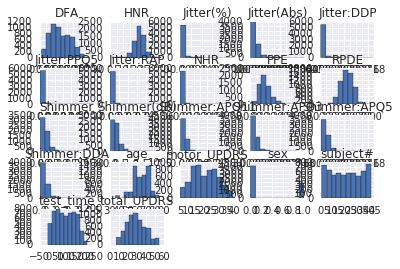

In [98]:
data.hist()
plt.rcParams['figure.figsize'] = (20, 15)
plt.show()

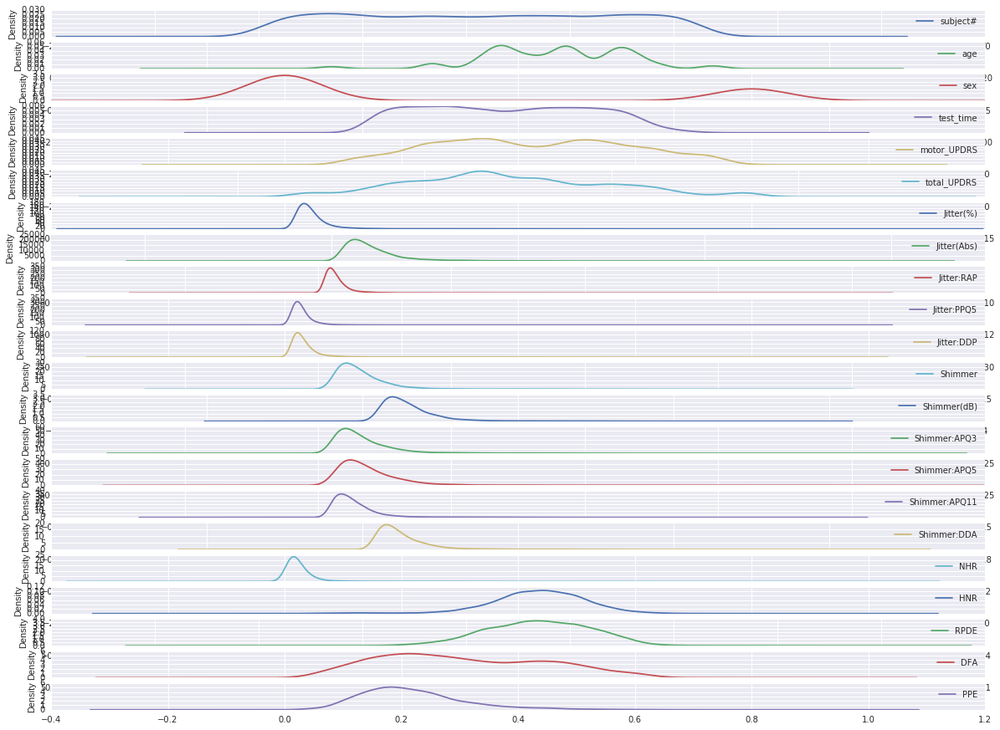

In [99]:
data.plot(kind='density', subplots=True,  sharex=False)
plt.show()

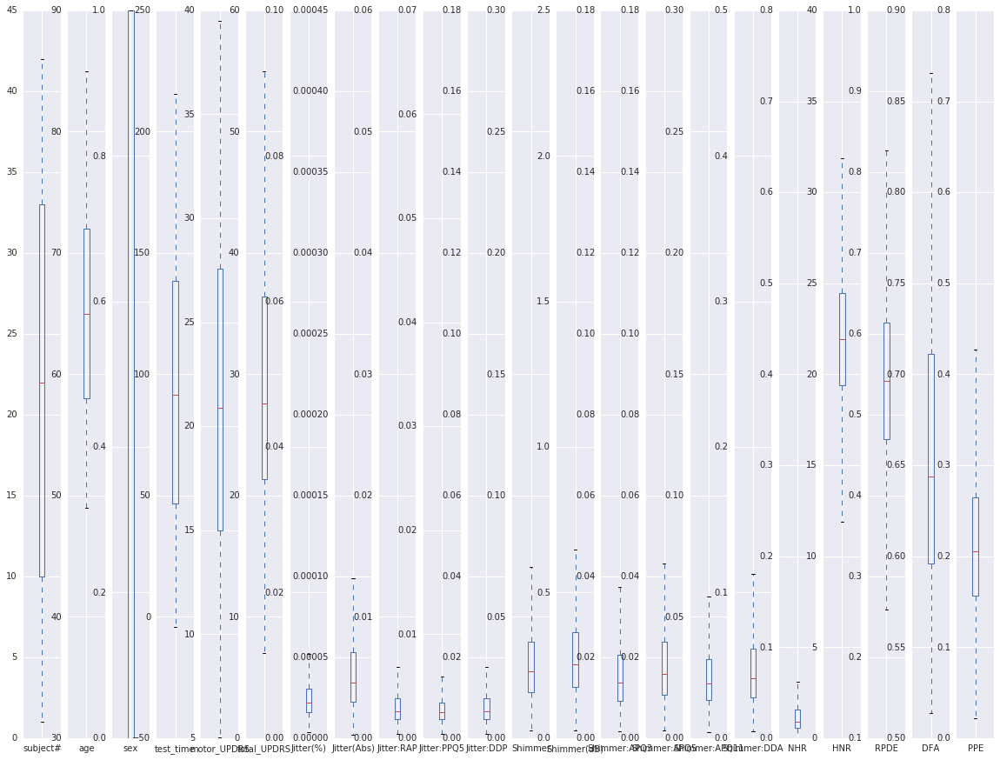

In [100]:
data.plot(kind='box', subplots=True,  sharex=False, sharey=False)
plt.show()

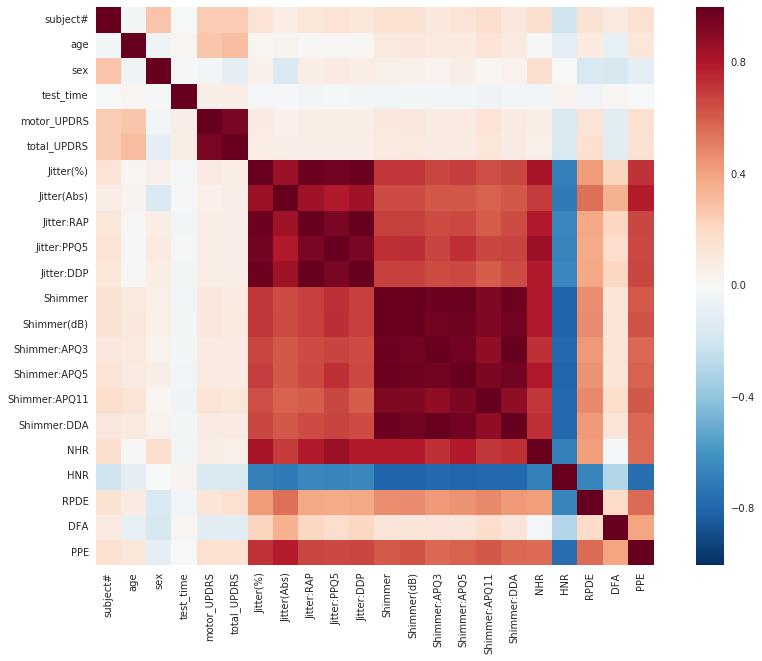

In [101]:
# Encode the categorical features as numbers
import seaborn as sns
def number_encode_features(df):
    result = df.copy()
    encoders = {}
    for column in result.columns:
        if result.dtypes[column] == np.object:
            encoders[column] = preprocessing.LabelEncoder()
            result[column] = encoders[column].fit_transform(result[column])
    return result, encoders

# Calculate the correlation and plot it
plt.rcParams['figure.figsize'] = (15, 10)
encoded_data, _ = number_encode_features(data)
sns.heatmap(encoded_data.corr(), square=True)
plt.show()

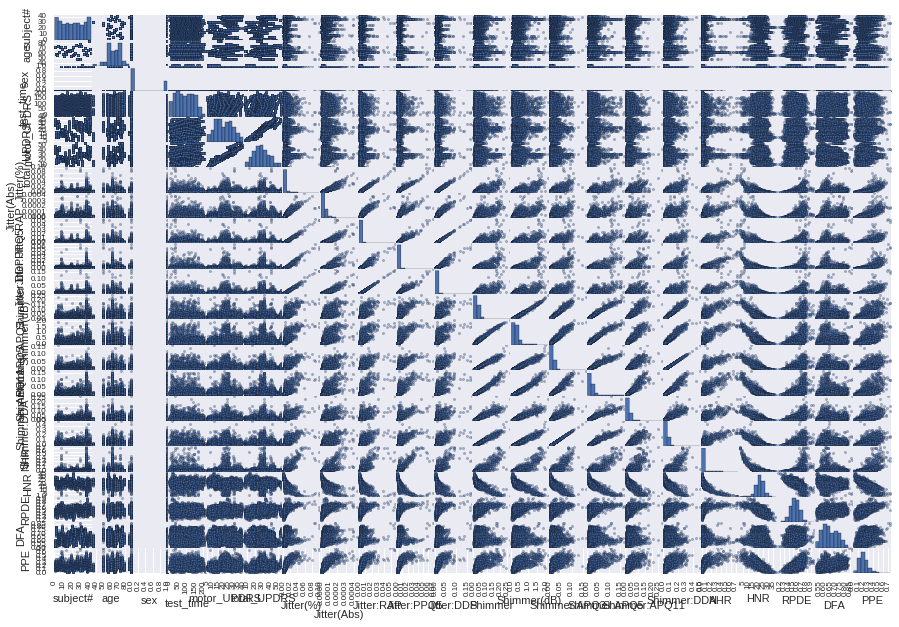

In [102]:
from pandas.tools.plotting import scatter_matrix
scatter_matrix(data)
plt.show()

In [103]:
import seaborn as sns
sns.pairplot(data, hue='motor_UPDRS')

# Prepare the data for classification

from sklearn import preprocessing
# for training data
dataset = data.values
X = dataset[:,0:13].astype(float)
Y = dataset[:,13]
features = preprocessing.scale(X)
motor_UPDRS = Y

# Make developement dataset for genrilization and final testing
from sklearn.cross_validation import train_test_split
# Extracting 20% testing data
X_train, X_test, y_train, y_test = train_test_split(
    features, motor_UPDRS, test_size=0.20, random_state=0)

print 'Number of training examples',len(X_train)
print 'Number of validation examples',len(X_test)

## Preproccing

from sklearn import preprocessing
# normalize the data attributes
#X_train = preprocessing.normalize(X_train)
#X_test = preprocessing.normalize(X_test)
# standardize the data attributes
X_train = preprocessing.scale(X_train)
X_test = preprocessing.scale(X_test)

np.save('./data/X_train', X_train)
np.save('./data/y_train', y_train)
np.save('./data/X_test', X_test)
np.save('./data/y_test', y_test)

# Final Conclusion

1. There is many outliter in the data
2. Some data is spasity
3. We can F regression to compute the the ranking of the features as once can remove or add new feature to the model as there is no scary from Anscombe's quartet. see https://en.wikipedia.org/wiki/Anscombe%27s_quartet
4. The good link to understand more is this q. http://stats.stackexchange.com/questions/204141/difference-between-selecting-features-based-on-f-regression-and-based-on-r2
